<a href="https://colab.research.google.com/github/npl0204/AirBnb-Price-Prediction/blob/main/NY_Listing_AirBnb_Price_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **NY Listing AirBnb Price Prediction**

#### Abstract
---

This cloud-based project focuses on analyzing **New York City Airbnb data** to predict rental prices and provide valuable insights for hosts and potential guests. The dataset used in this project is sourced from Inside Airbnb, offering comprehensive information about hosts, listing attributes, and review scores.

The primary objective is to explore the factors that significantly impact rental prices and develop accurate predictive models. Through an in-depth analysis, the project identifies the gradient-boosted tree regression model as the most accurate among the implemented machine learning models. Hyperparameter tuning is employed to optimize the model's performance.

The findings reveal that property type and neighborhood are key factors influencing rental prices. Our project offers actionable insights for hosts, empowering them to set competitive prices based on the identified factors. Additionally, potential guests can make informed decisions by leveraging the predicted rental prices.

## 1. Introduction
---

Finding an accomodation is the most typical problem to be solved, when travelling to other city or country. And one of the most important things in choosing an accomodation is the reservation price. What are the main factors, which affect the reservation prices? Does time of the year influence prices and what are the busiest times of the year to visit particular city? How can we save money on the reservation?

The goal of this project was to utilize to tools and techniques learned throgh this course to analyze the New York City Airbnb rental dataset obtained from Inside Airbnb through exploratory data analysis (EDA). We leveraged the power of cloud computing and Spark to perform data cleansing, exploratory data analysis, and develop machine learning models to predict rental prices accurately.

***Objectives***

The objectives of our project were as follows:
1. Clean and preprocess the Airbnb dataset to ensure data quality and consistency.
2. Conduct exploratory data analysis to identify significant patterns and trends within the dataset.
3. Build machine learning models to predict listing prices based on relevant features.
4. Evaluate the performance of different regression algorithms and identify the most effective model.
5. Fine-tune the selected model's hyperparameters to optimize its predictive capabilities.

***Data Analysis Methods and Techniques***

To accomplish our objectives, we employed cloud-based data analytics techniques, specifically using Databricks as our data processing platform. We accessed the New York City Airbnb dataset from Inside Airbnb, which provided information on host details, property characteristics, review scores, and pricing.

Our analysis involved several steps. Initially, we performed data cleaning, removing outliers and eliminating listings with erroneous or incomplete information. We then conducted exploratory data analysis to gain insights into super hosts, popular neighborhoods, and listing features. This involved visualizations, statistical summaries, and correlation analysis to uncover relationships between variables.

For the predictive modeling phase, we utilized various machine learning algorithms, including linear regression, decision tree regression, gradient-boosted tree regression, and random forest regression. We evaluated their performance based on RMSE and R2 scores to determine the most accurate and reliable model.

***Key Findings***

Through our data analysis, we discovered several key findings:

1. **Super hosts**: It was advisable to prioritize booking Airbnb units hosted by super hosts as they generally offered better services. However, the differences in review scores between super hosts and regular hosts were not significant, suggesting that being a super host should be considered as just one criterion.

2. **Popular neighborhoods**: Our analysis revealed that Bedford-Stuyvesant, located in the northern section of Brooklyn, had the highest number of listings on Airbnb. This indicates its popularity among both hosts and guests.

3. **Listing features**: The majority of listings were entire home/apartment rentals, with private rooms being the most expensive and the second most popular type of listing.

4. **Machine learning models**: After evaluating the performance of different regression algorithms, we determined that the gradient-boosted tree regression model outperformed the others. It achieved the lowest RMSE (41.24) and the highest R2 score (0.59), indicating its superior predictive capabilities.

5. **Hyperparameter tuning**: By fine-tuning the hyperparameters of the gradient-boosted tree regression model using Spark's ParamGridBuilder and 3-fold cross-validation, we achieved further improvements. The optimized model had a reduced RMSE of 31.48 and an increased R2 score of 0.75, indicating enhanced accuracy and explained variance.

These key findings provide valuable insights for both hosts and guests in making informed decisions about Airbnb listings in New York City. The optimized gradient-boosted tree regression model can serve as a reliable tool for predicting listing prices based on various features, aiding in pricing strategies and informed decision-making.

## 2. Problem Definition
---

The problem originates from the need for both hosts and potential guests to have an understanding of the fair market value of Airbnb rentals in different neighborhoods of New York City. The objective of this project is to analyze the New York City Airbnb dataset and explore the relationships between various features and rental prices. By doing so, we aim to identify the key factors that significantly impact rental prices and gain a deeper understanding of the rental market dynamics in different neighborhoods.

Furthermore, we aim to develop accurate predictive models for rental price estimation of Airbnb listings in New York City. With access to a comprehensive dataset containing information on host details, location, property type, and review scores, our goal is to build models that can accurately predict the rental prices of new listings based on their features. The ability to make accurate price predictions will assist hosts in setting competitive prices for their listings, while potential guests can make informed decisions based on the estimated prices.

## 3. Data
---

The data used in this project was sourced from Inside Airbnb, a website that provides publicly available Airbnb datasets for different cities. Specifically, we obtained the dataset for New York City Airbnb listings. This dataset serves as a valuable resource for understanding the characteristics and dynamics of the Airbnb market in the city.

The dataset is structured and likely available in formats such as CSV or Parquet. For our project, we downloaded the dataset as a CSV file and uploaded it to the Databricks File System (DBFS) for further processing and analysis.

The dataset contains a wide range of information related to New York City Airbnb listings. It includes details about the hosts, such as whether they are superhosts, the total number of listings they have, and their overall review scores. The dataset also provides information about the listings themselves, including their location (latitude and longitude), property type, room type, number of bedrooms and bathrooms, available amenities, minimum nights required for booking, and the number of reviews received.

To simplify our analysis, we selected a subset of columns to work with. The columns we chose to keep for our analysis include:
  - `host_is_superhost`
  - `instant_bookable`
  - `host_total_listings_count`
  - `neighbourhood_cleansed`
  - `latitude`
  - `longitude`
  - `property_type`
  - `room_type`
  - `accommodates`
  - `bathrooms`
  - `bedrooms`
  - `beds`
  - `minimum_nights`
  - `number_of_reviews`
  - `review_scores_rating`
  - `review_scores_accuracy`
  - `review_scores_cleanliness`
  - `review_scores_checkin`
  - `review_scores_communication`
  - `review_scores_location`
  - `review_scores_value`
  - `price`

During the data cleaning process, we performed necessary transformations and manipulations. For example, we converted the 'price' column from a string format to numeric for ease of analysis. We also removed extreme price values and listings with a price of 0, as those were considered outliers. Additionally, we filtered out listings with a price above $300 per day to focus on more affordable options.

### 3.1. Import Packages

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from pyspark.sql.functions import col

###3.2. Loading Dataset

In [ ]:
file_path = '/FileStore/tables/pn383/ny_listings.csv'
raw_df = spark.read.csv(file_path,
                        header="true",
                        inferSchema="true",
                        multiLine="true",
                        escape='"')

display(raw_df)

id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
801749842377802394,https://www.airbnb.com/rooms/801749842377802394,20230306014634,2023-03-06,city scrape,A home away from home,"The whole group will be comfortable in this spacious and unique space.Guest accessyou can enjoy the living room, dining room, kitchen and the backyard. The home has two entrances",null,https://a0.muscache.com/pictures/miso/Hosting-801749842377802394/original/bf54da63-4a14-4185-a2e2-919a959249bf.jpeg,495455523,https://www.airbnb.com/users/show/495455523,Michael,2023-01-10,null,null,N/A,N/A,N/A,f,https://a0.muscache.com/im/pictures/user/773edbb5-05e0-46f9-8a19-1fbcd3d841c3.jpg?aki_policy=profile_small,https://a0.muscache.com/im/pictures/user/773edbb5-05e0-46f9-8a19-1fbcd3d841c3.jpg?aki_policy=profile_x_medium,Canarsie,1,1,"['email', 'phone']",t,f,null,Canarsie,Brooklyn,40.640402656712844,-73.88853475272201,Private room in home,Private room,2,null,1 bath,1,1,"[""50\"" TV"", ""Bathtub"", ""Microwave"", ""Free driveway parking on premises"", ""Laundromat nearby"", ""Kitchen"", ""Refrigerator"", ""Central air conditioning"", ""Smoke alarm"", ""Central heating"", ""Free street parking"", ""Clothing storage: closet and walk-in closet"", ""Essentials"", ""Carbon monoxide alarm"", ""Dining table"", ""Stainless steel oven"", ""Wifi"", ""Ceiling fan"", ""Dedicated workspace"", ""Gas stove"", ""Cooking basics"", ""Private backyard"", ""Hot water kettle"", ""Bed linens"", ""Hot water""]",$143.00,2,30,2,2,30,30,2.0,30.0,null,t,30,60,90,364,2023-03-06,0,0,0,null,null,null,null,null,null,null,null,null,null,f,1,0,1,0,null
765948794133787266,https://www.airbnb.com/rooms/765948794133787266,20230306014634,2023-03-06,city scrape,Brooklyn Refuge,Take a break and unwind at this peaceful oasis.,null,https://a0.muscache.com/pictures/miso/Hosting-765948794133787266/original/b8df8f11-1125-49e5-b3c7-68e256400e90.jpeg,488760226,https://www.airbnb.com/users/show/488760226,Eric,2022-11-22,null,null,within an hour,100%,100%,f,https://a0.muscache.com/im/pictures/user/87e003f3-cac7-445a-ac05-d9fd9913989e.jpg?aki_policy=profile_small,https://a0.muscache.com/im/pictures/user/87e003f3-cac7-445a-ac05-d9fd9913989e.jpg?aki_policy=profile_x_medium,Canarsie,2,5,"['email', 'phone']",t,t,null,Canarsie,Brooklyn,40.64851,-73.89433,Private room in rental unit,Private room,1,null,1 shared bath,1,1,"[""Free parking on premises"", ""Carbon monoxide alarm"", ""First aid kit"", ""Wifi"", ""TV"", ""Smoke alarm"", ""Kitchen""]",$30.00,2,1125,2,2,1125,1125,2.0,1125.0,null,t,15,19,38,41,2023-03-06,13,13,5,2022-12-06,2023-02-19,4.85,4.77,4.77,4.85,4.92,4.85,4.92,null,t,2,1,1,0,4.29
636274456676328779,https://www.airbnb.com/rooms/636274456676328779,20230306014

In [ ]:
raw_df.columns

Out[110]: ['id',
 'listing_url',
 'scrape_id',
 'last_scraped',
 'source',
 'name',
 'description',
 'neighborhood_overview',
 'picture_url',
 'host_id',
 'host_url',
 'host_name',
 'host_since',
 'host_location',
 'host_about',
 'host_response_time',
 'host_response_rate',
 'host_acceptance_rate',
 'host_is_superhost',
 'host_thumbnail_url',
 'host_picture_url',
 'host_neighbourhood',
 'host_listings_count',
 'host_total_listings_count',
 'host_verifications',
 'host_has_profile_pic',
 'host_identity_verified',
 'neighbourhood',
 'neighbourhood_cleansed',
 'neighbourhood_group_cleansed',
 'latitude',
 'longitude',
 'property_type',
 'room_type',
 'accommodates',
 'bathrooms',
 'bathrooms_text',
 'bedrooms',
 'beds',
 'amenities',
 'price',
 'minimum_nights',
 'maximum_nights',
 'minimum_minimum_nights',
 'maximum_minimum_nights',
 'minimum_maximum_nights',
 'maximum_maximum_nights',
 'minimum_nights_avg_ntm',
 'maximum_nights_avg_ntm',
 'calendar_updated',
 'has_availability',
 'availability_30',
 'availability_60',
 'availability_90',
 'availability_365',
 'calendar_last_scraped',
 'number_of_reviews',
 'number_of_reviews_ltm',
 'number_of_reviews_l30d',
 'first_review',
 'last_review',
 'review_scores_rating',
 'review_scores_accuracy',
 'review_scores_cleanliness',
 'review_scores_checkin',
 'review_scores_communication',
 'review_scores_location',
 'review_scores_value',
 'license',
 'instant_bookable',
 'calculated_host_listings_count',
 'calculated_host_listings_count_entire_homes',
 'calculated_host_listings_count_private_rooms',
 'calculated_host_listings_count_shared_rooms',
 'reviews_per_month']

For the sake of simplicity, only keep certain columns from this dataset.

In [ ]:
columns_to_keep = [
    "host_is_superhost",
    "instant_bookable",
    "host_total_listings_count",
    "neighbourhood_cleansed",
    "neighbourhood_group_cleansed",
    "latitude",
    "longitude",
    "property_type",
    "room_type",
    "accommodates",
    "bathrooms_text",
    "bedrooms",
    "beds",
    "minimum_nights",
    "number_of_reviews",
    "review_scores_rating",
    "review_scores_accuracy",
    "review_scores_cleanliness",
    "review_scores_checkin",
    "review_scores_communication",
    "review_scores_location",
    "review_scores_value",
    "price"
]

df = raw_df.select(columns_to_keep)
df.cache().count()
display(df)

host_is_superhost,instant_bookable,host_total_listings_count,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price
f,f,1,Canarsie,Brooklyn,40.640402656712844,-73.88853475272201,Private room in home,Private room,2,1 bath,1,1,2,0,null,null,null,null,null,null,null,$143.00
f,t,5,Canarsie,Brooklyn,40.64851,-73.89433,Private room in rental unit,Private room,1,1 shared bath,1,1,2,13,4.85,4.77,4.77,4.85,4.92,4.85,4.92,$30.00
f,f,1,Tottenville,Staten Island,40.507114,-74.251907,Entire villa,Entire home/apt,6,2 baths,2,2,1,0,null,null,null,null,null,null,null,$157.00
t,t,7,Sheepshead Bay,Brooklyn,40.58349,-73.95988,Private room in home,Private room,2,2 baths,3,1,1,15,5.0,5.0,4.87,5.0,5.0,5.0,5.0,$89.00
f,f,2,North Riverdale,Bronx,40.90326,-73.90709,Entire rental unit,Entire home/apt,3,1 bath,2,2,3,25,4.48,4.56,4.44,4.72,4.88,4.72,4.64,$125.00
f,t,7,Flushing,Queens,40.7635,-73.82608,Private room in rental unit,Private room,3,1 shared bath,1,1,2,40,4.68,4.88,4.55,4.78,4.78,4.93,4.68,$63.00
f,f,1,Whitestone,Queens,40.7861826,-73.8217578,Private room in home,Private room,2,1 shared bath,1,1,1,0,null,null,null,null,null,null,null,$82.00
f,f,1,Prince's Bay,Staten Island,40.52339,-74.20517,Entire rental unit,Entire home/apt,3,1 bath,1,3,7,3,5.0,5.0,5.0,5.0,5.0,5.0,5.0,$118.00
f,f,20,Richmond Hill,Queens,40.70015,-73.82713,Private room in home,Private room,1,1 shared bath,1,1,5,1,5.0,5.0,5.0,5.0,5.0,5.0,5.0,$49.00
t,f,2,Kingsbridge,Bronx,40.88232,-73.90621,Entire rental unit,Entire home/apt,4,1 bath,2,2,30,16,5.0,4.93,4.93,4.93,4.93,4.8,4.73,$115.00


## 4. Exploratory Data Analysis
---
*(Cleanse, wrangle, transform, and analyze the data. Compute descriptive statistics and visualize the values of features and correlations between different features. Explain the process and the results.)*

### 4.1. Data Cleansing

#### Fixing Data Types

Based on the above data scheme, we realize that `price` feature is defined as string. For our task, we need it to be a numeric/double type.

In [ ]:
from pyspark.sql.functions import col, translate

df = df.withColumn("price", translate(col("price"), "$,", "").cast("double"))

display(df)

host_is_superhost,instant_bookable,host_total_listings_count,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price
f,f,1,Canarsie,Brooklyn,40.640402656712844,-73.88853475272201,Private room in home,Private room,2,1 bath,1,1,2,0,null,null,null,null,null,null,null,143.0
f,t,5,Canarsie,Brooklyn,40.64851,-73.89433,Private room in rental unit,Private room,1,1 shared bath,1,1,2,13,4.85,4.77,4.77,4.85,4.92,4.85,4.92,30.0
f,f,1,Tottenville,Staten Island,40.507114,-74.251907,Entire villa,Entire home/apt,6,2 baths,2,2,1,0,null,null,null,null,null,null,null,157.0
t,t,7,Sheepshead Bay,Brooklyn,40.58349,-73.95988,Private room in home,Private room,2,2 baths,3,1,1,15,5.0,5.0,4.87,5.0,5.0,5.0,5.0,89.0
f,f,2,North Riverdale,Bronx,40.90326,-73.90709,Entire rental unit,Entire home/apt,3,1 bath,2,2,3,25,4.48,4.56,4.44,4.72,4.88,4.72,4.64,125.0
f,t,7,Flushing,Queens,40.7635,-73.82608,Private room in rental unit,Private room,3,1 shared bath,1,1,2,40,4.68,4.88,4.55,4.78,4.78,4.93,4.68,63.0
f,f,1,Whitestone,Queens,40.7861826,-73.8217578,Private room in home,Private room,2,1 shared bath,1,1,1,0,null,null,null,null,null,null,null,82.0
f,f,1,Prince's Bay,Staten Island,40.52339,-74.20517,Entire rental unit,Entire home/apt,3,1 bath,1,3,7,3,5.0,5.0,5.0,5.0,5.0,5.0,5.0,118.0
f,f,20,Richmond Hill,Queens,40.70015,-73.82713,Private room in home,Private room,1,1 shared bath,1,1,5,1,5.0,5.0,5.0,5.0,5.0,5.0,5.0,49.0
t,f,2,Kingsbridge,Bronx,40.88232,-73.90621,Entire rental unit,Entire home/apt,4,1 bath,2,2,30,16,5.0,4.93,4.93,4.93,4.93,4.8,4.73,115.0


#### Getting Rid of Extreme Values

##### `price`

In [ ]:
display(df.select("price").describe())

summary,price
count,42931
mean,200.30716731499382
stddev,895.082911473014
min,0.0
max,99000.0


When taking a look at the min and max values of the `price` column, there are a few high-priced listings, here, we will filter out the Airbnb listings that are marked as "free".

In [ ]:
# Count how many listings with price is zero
print(df.filter(col("price") == 0).count())

# Keep rows with a strictly positive price
df = df.filter(col("price") > 0)

27

We also visualize the distribution of the feature `price` to check outliners if they have any.

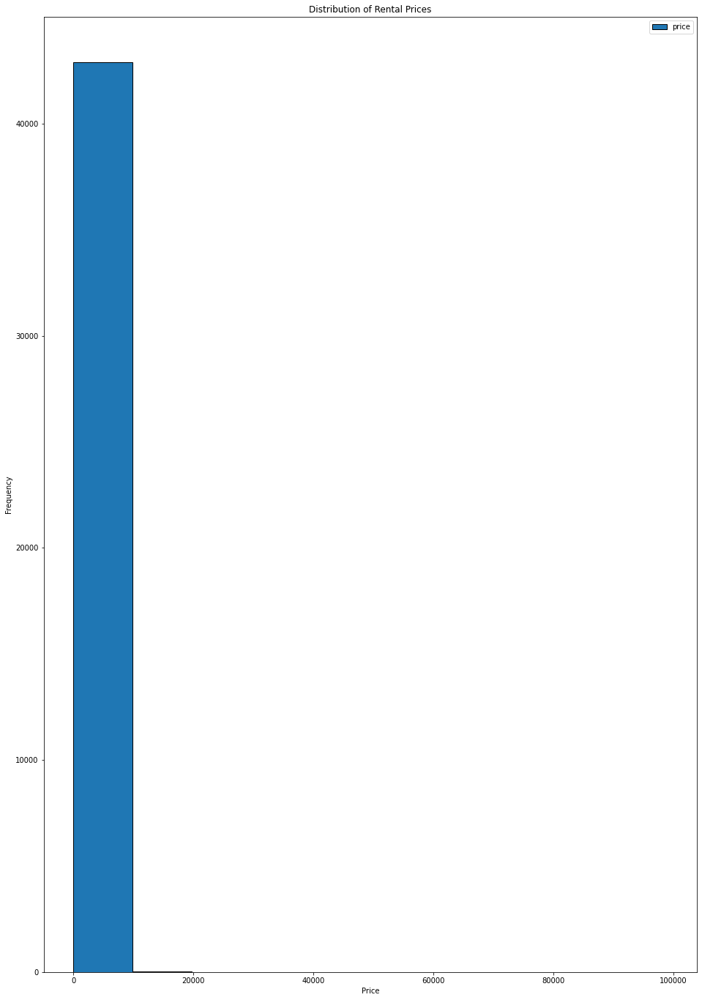

In [ ]:
# Plotting a histogram of prices
df.select("price").toPandas().plot.hist(edgecolor='black')
plt.xlabel("Price")
plt.ylabel("Frequency")
plt.title("Distribution of Rental Prices")
plt.show()

Based on the box plot, we decided that we will filter out the listings that are has the price of more than $300 since it make our dataset skewed-left. We believe that it is reasonable to do so since the price listed is the price for a day.

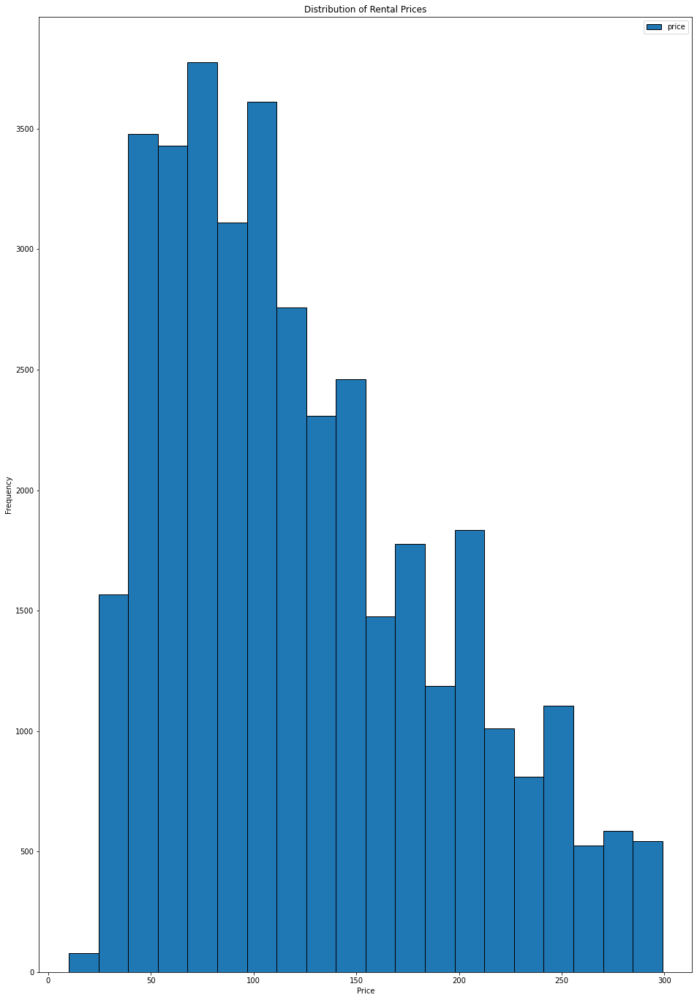

In [ ]:
# Keep rows with price < 300
df = df.filter(col("price") < 300)

# Plotting a histogram of prices
df.select("price").toPandas().plot.hist(bins=20, edgecolor="black")
plt.xlabel("Price")
plt.ylabel("Frequency")
plt.title("Distribution of Rental Prices")
plt.show()

The updated plot reveals a significantly improved distribution of prices, making it easier to interpret. By filtering out listings with prices exceeding $300, we have created a more representative dataset for further analysis. This filtering step helps ensure that the remaining listings provide a clearer understanding of the price range and patterns within the dataset.

##### `number_of_reviews`

Similar to `price`, we also want to take only housing that have at least 1 reviews since it will be helpful for our exploratory and future prediction.

In [ ]:
display(df.select("number_of_reviews").describe())

summary,number_of_reviews
count,37430
mean,27.243628105797487
stddev,58.302569827947046
min,0
max,1842


In [ ]:
# count how many listings with number_of_reviews is zero
print(df.filter(col("number_of_reviews") == 0).count())

# keep rows with a strictly positive number_of_reviews
df = df.filter(col("number_of_reviews") > 0)

8055

#####`minimum_nights`

We will filter out those records where the `minimum_nights` is greater then 365.

In [ ]:
display(df.select("minimum_nights").describe())

summary,minimum_nights
count,29375
mean,16.248510638297873
stddev,25.24444655469137
min,1
max,1250


In [ ]:
display(df
        .groupBy("minimum_nights").count()
        .orderBy(col("count").desc(), col("minimum_nights"))
       )

minimum_nights,count
30,11950
1,5531
2,4325
3,2926
4,1081
5,1069
7,649
6,260
31,214
14,182


In [ ]:
df = df.filter(col("minimum_nights") <= 365)
display(df)

host_is_superhost,instant_bookable,host_total_listings_count,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price
f,t,5,Canarsie,Brooklyn,40.64851,-73.89433,Private room in rental unit,Private room,1,1 shared bath,1,1,2,13,4.85,4.77,4.77,4.85,4.92,4.85,4.92,30.0
t,t,7,Sheepshead Bay,Brooklyn,40.58349,-73.95988,Private room in home,Private room,2,2 baths,3,1,1,15,5.0,5.0,4.87,5.0,5.0,5.0,5.0,89.0
f,f,2,North Riverdale,Bronx,40.90326,-73.90709,Entire rental unit,Entire home/apt,3,1 bath,2,2,3,25,4.48,4.56,4.44,4.72,4.88,4.72,4.64,125.0
f,t,7,Flushing,Queens,40.7635,-73.82608,Private room in rental unit,Private room,3,1 shared bath,1,1,2,40,4.68,4.88,4.55,4.78,4.78,4.93,4.68,63.0
f,f,1,Prince's Bay,Staten Island,40.52339,-74.20517,Entire rental unit,Entire home/apt,3,1 bath,1,3,7,3,5.0,5.0,5.0,5.0,5.0,5.0,5.0,118.0
f,f,20,Richmond Hill,Queens,40.70015,-73.82713,Private room in home,Private room,1,1 shared bath,1,1,5,1,5.0,5.0,5.0,5.0,5.0,5.0,5.0,49.0
t,f,2,Kingsbridge,Bronx,40.88232,-73.90621,Entire rental unit,Entire home/apt,4,1 bath,2,2,30,16,5.0,4.93,4.93,4.93,4.93,4.8,4.73,115.0
f,t,1,Queens Village,Queens,40.70958479999999,-73.7461193,Entire home,Entire home/apt,4,1 bath,3,5,1,2,5.0,5.0,5.0,5.0,5.0,5.0,5.0,179.0
f,f,2,Far Rockaway,Queens,40.59614,-73.76051,Entire rental unit,Entire home/apt,7,1 bath,3,5,1,17,4.76,4.82,4.88,5.0,4.82,4.24,4.82,172.0
f,f,2,Richmond Hill,Queens,40.69501,-73.82562,Private room in home,Private room,1,1 shared bath,1,1,1,6,5.0,4.83,4.83,4.83,5.0,4.83,4.83,68.0


#### Handling Null Values

In [ ]:
display(df.summary())

summary,host_is_superhost,instant_bookable,host_total_listings_count,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price
count,29366,29366,29363,29366,29366,29366,29366,29366,29366,29366,29339,26584,28867,29366,29366,29366,28969,28979,28965,28974,28962,28962,29366
mean,null,null,26.81687838436127,null,null,40.726481584309525,-73.938929720715,null,null,2.723796226929102,null,1.2808832380379176,1.5462985415872796,16.03064768780222,34.72267247837635,4.628647415378351,4.7465442369429836,4.625113703026361,4.812098739858492,4.810845930834594,4.722017816449192,4.641003729024282,125.23326295716134
stddev,null,null,233.99363247314403,null,null,0.059867931286898726,0.058344484320407494,null,null,1.5957835553992539,null,0.6021205696223091,0.9407528926130192,21.158059720391538,63.81981420631263,0.7221934651943234,0.47028602264415864,0.5470812350212259,0.4198929371109791,0.435620882156977,0.4203257338674934,0.4996330866582989,64.67520238178035
min,f,f,1,Allerton,Bronx,40.50031443485432,-74.24984,Barn,Entire home/apt,1,0 baths,1,1,1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0
25%,null,null,1,null,null,40.68469,-73.97739,null,null,2,null,1,1,2,3,4.59,4.7,4.5,4.8,4.8,4.62,4.53,73.0
50%,null,null,3,null,null,40.71997,-73.94844,null,null,2,null,1,1,5,10,4.82,4.89,4.8,4.95,4.96,4.83,4.77,112.0
75%,null,null,6,null,null,40.76299,-73.91918,null,null,4,null,1,2,30,37,5.0,5.0,5.0,5.0,5.0,5.0,4.95,168.0
max,t,t,8298,Woodside,Staten Island,40.911146835736226,-73.71087,Tiny home,Shared room,16,Shared half-bath,11,21,365,1842,5.0,5.0,5.0,5.0,5.0,5.0,5.0,299.0


In [ ]:
# Are there any columns with missing values? Print summary statistics for all the columns using the describe().toPandas() method
missing_columns = [column for column in df.columns if df.filter(df[column].isNull()).count() > 0]

if len(missing_columns) > 0:
    print("Columns with missing values:", missing_columns)
else:
    print("No columns with missing values.")

df.describe().toPandas()

Columns with missing values: ['host_total_listings_count', 'bathrooms_text', 'bedrooms', 'beds', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication', 'review_scores_location', 'review_scores_value']
Out[89]:

,summary,host_is_superhost,instant_bookable,host_total_listings_count,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price
0,count,29366,29366,29363,29366,29366,29366,29366,29366,29366,29366,29339,26584,28867,29366,29366,29366,28969,28979,28965,28974,28962,28962,29366
1,mean,None,None,26.81687838436127,None,None,40.726481584309525,-73.938929720715,None,None,2.723796226929102,None,1.2808832380379176,1.5462985415872796,16.03064768780222,34.72267247837635,4.628647415378351,4.7465442369429836,4.625113703026361,4.812098739858492,4.810845930834594,4.722017816449192,4.641003729024282,125.23326295716134
2,stddev,None,None,233.99363247314403,None,None,0.059867931286898726,0.058344484320407494,None,None,1.5957835553992539,None,0.6021205696223091,0.9407528926130192,21.158059720391538,63.81981420631263,0.7221934651943234,0.47028602264415864,0.5470812350212259,0.4198929371109791,0.435620882156977,0.4203257338674934,0.4996330866582989,64.67520238178035
3,min,f,f,1,Allerton,Bronx,40.50031443485432,-74.24984,Barn,Entire home/apt,1,0 baths,1,1,1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0
4,max,t,t,8298,Woodside,Staten Island,40.911146835736226,-73.71087,Tiny home,Shared room,16,Shared half-bath,11,21,365,1842,5.0,5.0,5.0,5.0,5.0,5.0,5.0,299.0


In [ ]:
# Drop rows with duplicate values
df = df.dropDuplicates()

# # Drop columns with only one unique value
df = df.select([col for col in df.columns if df.select(col).distinct().count() > 1])

# Display the resulting DataFrame
display(df.summary())

summary,host_is_superhost,instant_bookable,host_total_listings_count,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price
count,29365,29365,29362,29365,29365,29365,29365,29365,29365,29365,29338,26583,28866,29365,29365,29365,28968,28978,28964,28973,28961,28961,29365
mean,null,null,26.80665486002316,null,null,40.72648110751003,-73.93893159449098,null,null,2.7238208751915547,null,1.2808938043110258,1.546317466916095,16.030171973437767,34.72382087519156,4.628634769283144,4.746535487434397,4.625100766098411,4.812092252451306,4.8108394022020455,4.72200821794826,4.640991333172182,125.23585901583517
stddev,null,null,233.99105906175564,null,null,0.0598688949315435,0.05834459417118126,null,null,1.5958051374905213,null,0.6021294305610324,0.9407636929044247,21.158262938496726,63.82059747350375,0.7222025108586407,0.47029178233475716,0.5470862421126123,0.4198987342016323,0.4356269825578219,0.42032981665201574,0.49963725926254865,64.67477354378768
min,f,f,1,Allerton,Bronx,40.50031443485432,-74.24984,Barn,Entire home/apt,1,0 baths,1,1,1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0
25%,null,null,1,null,null,40.68468,-73.9774,null,null,2,null,1,1,2,3,4.59,4.7,4.5,4.8,4.8,4.62,4.53,73.0
50%,null,null,3,null,null,40.71997,-73.94844,null,null,2,null,1,1,5,10,4.82,4.89,4.8,4.95,4.96,4.83,4.77,112.0
75%,null,null,6,null,null,40.76299,-73.91918,null,null,4,null,1,2,30,37,5.0,5.0,5.0,5.0,5.0,5.0,4.95,168.0
max,t,t,8298,Woodside,Staten Island,40.911146835736226,-73.71087,Tiny home,Shared room,16,Shared half-bath,11,21,365,1842,5.0,5.0,5.0,5.0,5.0,5.0,5.0,299.0


In [ ]:
from pyspark.sql.functions import col, count, sum

# Calculate the percentage of missing values for each column
missing_percentages = df.select([
    (100 * sum(col(column).isNull().cast("integer")) / count("*")).alias(column)
    for column in df.columns
]).toPandas()

missing_percentages = pd.DataFrame({"Feature": missing_percentages.columns,
                                    "Missing Percentage": missing_percentages.iloc[0].values})

missing_percentages = missing_percentages[missing_percentages["Missing Percentage"] > 0].sort_values("Missing Percentage", ascending = False)

# Show the columns with their missing value percentages
display(missing_percentages)

Feature,Missing Percentage
bedrooms,9.47354082953075
beds,1.6992440237008786
review_scores_location,1.3757406524552203
review_scores_value,1.3757406524552203
review_scores_checkin,1.3655247565211468
review_scores_accuracy,1.3519035619423823
review_scores_communication,1.3348770687189266
review_scores_cleanliness,1.317850575495471
bathrooms_text,0.09194306340666077
host_total_listings_count,0.010215895934073418


Features with missing values is: `bedrooms`, `beds`, `review_scores_location`, `review_scores_value`, `review_scores_checkin`, `review_scores_accuracy`, `review_scores_communication`, `review_scores_cleanliness`, `bathrooms_text`, and `host_total_listings_count`

To address missing data in our dataset, we utilized 3 distinct approaches depending on the data type of each feature:
* For review scores related features, since there is no missing value in `review_scores_rating`, we will replace missing values in `review_scores_location`, `review_scores_value`, `review_scores_checkin`, `review_scores_accuracy`, `review_scores_communication`, and `review_scores_cleanliness` with the `review_scores_rating`.
* For features `bathrooms_text`, and `host_total_listings_count`, since the missing percentages is lower than 0.1%, we will just drop rows with missing values from these features.
* For `bedrooms` and `beds` features, which are all numeric types, we opted to replace missing values with the median value derived from the available data. This method is resilient to outliers and prevents undue distortion of the variable's distribution. This will be done by using Imputer function, which uses the imputation estimator for completing missing values, using the mean, median or mode of the columns in which the missing values are located.

In [ ]:
from pyspark.ml.feature import Imputer

# Drop rows with missing values in "bathrooms_text", and "host_total_listings_count" columns
df = df.dropna(subset=["bathrooms_text", "host_total_listings_count"])

# Fill null values with "review_scores_rating" value using Imputer
review_scores = [
    "review_scores_accuracy",
    "review_scores_cleanliness",
    "review_scores_checkin",
    "review_scores_communication",
    "review_scores_location",
    "review_scores_value"
]
rating_value = df.select("review_scores_rating").first()[0]
df = df.fillna(rating_value, subset=review_scores)

# Fill null values in "bedrooms" and "beds" with median using Imputer
impute_cols = ["bedrooms", "beds"]
imputer = Imputer(strategy="median", inputCols=impute_cols, outputCols=impute_cols)
df = imputer.fit(df).transform(df)

In [ ]:
display(df.summary())

summary,host_is_superhost,instant_bookable,host_total_listings_count,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,minimum_nights,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price
count,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336,29336
mean,null,null,26.826493046086718,null,null,40.72648107597605,-73.93889820011307,null,null,2.7243318789200983,null,1.2544995909462777,1.537462503408781,16.014419143714207,34.74161439869103,4.629306653940572,4.748128238342044,4.62838389691852,4.812699754567837,4.811421802563497,4.7237240932643365,4.644020316334958,125.22371829833652
stddev,null,null,234.098866331395,null,null,0.059878267948230916,0.05836135343601155,null,null,1.596011646433794,null,0.5789885579733179,0.9357186608503846,21.066069175808046,63.84686315012571,0.7206192036890583,0.4669235200762398,0.5438007849344679,0.41692725271056186,0.4327611925262915,0.4177737977240768,0.49674632664503204,64.66418206678298
min,f,f,1,Allerton,Bronx,40.50031443485432,-74.24984,Barn,Entire home/apt,1,0 baths,1,1,1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0
25%,null,null,1,null,null,40.68468,-73.97738,null,null,2,null,1,1,2,3,4.59,4.7,4.5,4.8,4.8,4.63,4.54,73.0
50%,null,null,3,null,null,40.71997,-73.94842,null,null,2,null,1,1,5,10,4.82,4.89,4.8,4.94,4.96,4.84,4.77,112.0
75%,null,null,6,null,null,40.763,-73.91915,null,null,4,null,1,2,30,37,5.0,5.0,5.0,5.0,5.0,5.0,4.95,168.0
max,t,t,8298,Woodside,Staten Island,40.911146835736226,-73.71087,Tiny home,Shared room,16,Shared half-bath,11,21,365,1842,5.0,5.0,5.0,5.0,5.0,5.0,5.0,299.0


## 5. Modeling and Evaluation
---

In [ ]:
columns_to_keep = [
    "host_is_superhost",
    "instant_bookable",
    "host_total_listings_count",
    "neighbourhood_cleansed",
    "property_type",
    "room_type",
    "accommodates",
    "bathrooms_text",
    "bedrooms",
    "beds",
    "minimum_nights",
    "number_of_reviews",
    "review_scores_rating",
    "review_scores_accuracy",
    "review_scores_cleanliness",
    "review_scores_checkin",
    "review_scores_communication",
    "review_scores_location",
    "review_scores_value",
    "price"
]

df = df.select(columns_to_keep)

In [ ]:
train_df, test_df = df.randomSplit([.8, .2], seed=42)
print(train_df.cache().count())

23386

In [ ]:
rmse_score = []
r2_score = []
model_name = []

### 5.1. Linear Regression

In [ ]:
from pyspark.ml.regression import LinearRegression

lr = LinearRegression(labelCol="price", featuresCol="features")

**Handling Categorical Variables**

There are several approaches to handle categorical features in data analysis:
* Assigning numeric values to the categories
* Creating "dummy" variables using One Hot Encoding (OHE)
* Generating embeddings, primarily used for textual data

**One Hot Encoding (OHE)**

In this project, we will use One Hot Encoding to transform our categorical variables. In Spark, the process of OHE involves two steps.
* First, we utilize the `StringIndexer` class to map the string labels in a column to label indices, creating a new column with these indices.
* Next, we apply the `OneHotEncoder` class to the output of the StringIndexer, which converts the label indices into sparse binary vectors representing the presence or absence of each category.

This approach allows us to handle categorical variables effectively in our data analysis pipeline.

In [ ]:
from pyspark.ml.feature import OneHotEncoder, StringIndexer

categorical_cols = [field for (field, dataType) in train_df.dtypes if dataType == "string"]
index_output_cols = [x + "Index" for x in categorical_cols]
ohe_output_cols = [x + "OHE" for x in categorical_cols]

string_indexer = StringIndexer(inputCols=categorical_cols, outputCols=index_output_cols, handleInvalid="skip")
ohe_encoder = OneHotEncoder(inputCols=index_output_cols, outputCols=ohe_output_cols)

Now we can combine our OHE categorical features with our numeric features using **Vector Assembler**.

In [ ]:
from pyspark.ml.feature import VectorAssembler

numeric_cols = [field for (field, dataType) in train_df.dtypes if ((dataType == "double") & (field != "price"))]
assembler_inputs = ohe_output_cols + numeric_cols
vec_assembler = VectorAssembler(inputCols=assembler_inputs, outputCol="features")

# List of the column names that correspond to the indices in the "features" column
feature_names = vec_assembler.getInputCols()
print(feature_names)

['host_is_superhostOHE', 'instant_bookableOHE', 'neighbourhood_cleansedOHE', 'property_typeOHE', 'room_typeOHE', 'bathrooms_textOHE', 'review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication', 'review_scores_location', 'review_scores_value']

To streamline the process and ensure consistency in applying transformations to our datasets, we can encapsulate all the stages in a Pipeline. A [Pipeline](https://spark.apache.org/docs/latest/api/python/reference/api/pyspark.ml.Pipeline.html?highlight=pipeline#pyspark.ml.Pipeline) in Spark is a convenient way to organize and chain together multiple transformers and estimators.

By using a Pipeline, we eliminate the need to manually keep track of the order in which transformations should be applied. This ensures that the same sequence of transformations is consistently applied to both the training and test datasets, simplifying our data processing workflow.

In [ ]:
from pyspark.ml import Pipeline

stages = [string_indexer, ohe_encoder, vec_assembler, lr]
pipeline = Pipeline(stages=stages)

pipeline_model = pipeline.fit(train_df)

In [ ]:
pred_df = pipeline_model.transform(test_df)
display(pred_df.select("features", "price", "prediction"))

In [ ]:
from pyspark.ml.evaluation import RegressionEvaluator

regression_evaluator = RegressionEvaluator(predictionCol="prediction", labelCol="price", metricName="rmse")

rmse = regression_evaluator.evaluate(pred_df)
r2 = regression_evaluator.setMetricName("r2").evaluate(pred_df)

rmse_score.append(rmse)
r2_score.append(r2)
model_name.append("Linear Regression")

print(f"RMSE is {rmse}")
print(f"R2 is {r2}")

RMSE is 44.039557755488424
R2 is 0.5279496109085159

### 5.2. Decision Tree Regression

In [ ]:
from pyspark.ml.regression import DecisionTreeRegressor

dt = DecisionTreeRegressor(labelCol="price", maxBins=220)

**No OneHotEncoder**

In the previous model using linear regression, we explored the use of techniques like StringIndexer, OneHotEncoder, and VectorAssembler. However, when working with decision trees, especially random forests, it is advised not to use OneHotEncoder for categorical variables.

A [blog](https://towardsdatascience.com/one-hot-encoding-is-making-your-tree-based-ensembles-worse-heres-why-d64b282b5769#:~:text=One%2Dhot%20encoding%20categorical%20variables,importance%20resulting%20in%20poorer%20performance) explains this concept in detail. Essentially, one-hot encoding categorical variables with high cardinality can introduce inefficiency in tree-based algorithms. The algorithm may assign more importance to continuous variables compared to the dummy variables, which can obscure the true order of feature importance and potentially lead to decreased performance.

It is important to consider this limitation when applying random forests or other tree-based methods, and alternative encoding strategies or feature engineering techniques may be more appropriate in such cases.

In [ ]:
categorical_cols = [field for (field, dataType) in train_df.dtypes if dataType == "string"]
index_output_cols = [x + "Index" for x in categorical_cols]
string_indexer = StringIndexer(inputCols=categorical_cols, outputCols=index_output_cols, handleInvalid="skip")
# Combine output of StringIndexer and numeric columns (without OHE)
assembler_inputs = index_output_cols + numeric_cols
vec_assembler = VectorAssembler(inputCols=assembler_inputs, outputCol="features")

stages = [string_indexer, vec_assembler, dt]
pipeline = Pipeline(stages=stages)

In [ ]:
pipeline_model = pipeline.fit(train_df)
pred_df = pipeline_model.transform(test_df)
display(pred_df.select("features", "price", "prediction"))

In [ ]:
regression_evaluator = RegressionEvaluator(predictionCol="prediction", labelCol="price", metricName="rmse")
rmse = regression_evaluator.evaluate(pred_df)
r2 = regression_evaluator.setMetricName("r2").evaluate(pred_df)

rmse_score.append(rmse)
r2_score.append(r2)
model_name.append("Decision Tree")

print(f"RMSE is {rmse}")
print(f"R2 is {r2}")

RMSE is 44.255658762554624
R2 is 0.523305565812556

**Features important scores**

Feature importance indicates the relative importance or contribution of each feature towards making predictions in the model.

In [ ]:
dt_model = pipeline_model.stages[-1]
display(dt_model)

In [ ]:
dt_model.featureImportances

Out[52]: SparseVector(13, {0: 0.0079, 2: 0.1714, 3: 0.7172, 5: 0.0998, 6: 0.0019, 8: 0.0018})

In [ ]:
features_df = pd.DataFrame(list(zip(vec_assembler.getInputCols(), dt_model.featureImportances)), columns=["feature", "importance"])
features_df

Out[53]:

,feature,importance
0,host_is_superhostIndex,0.007881
1,instant_bookableIndex,0.000000
2,neighbourhood_cleansedIndex,0.171433
3,property_typeIndex,0.717228
4,room_typeIndex,0.000000
5,bathrooms_textIndex,0.099796
6,review_scores_rating,0.001910
7,review_scores_accuracy,0.000000
8,review_scores_cleanliness,0.001752
9,review_scores_checkin,0.000000


The given result shows the feature importance values for each feature in a model.

Interpreting the result:

1. `property_typeIndex`: This feature has the highest importance value of 0.717228, indicating it has the most significant impact on the model's predictions.
2. `neighbourhood_cleansedIndex`: This feature has an importance of 0.171433, suggesting it plays a significant role in the model's predictions.
3. `bathrooms_textIndex`: This feature has an importance of 0.099796, suggesting a moderate impact on the model's predictions.
4. `host_is_superhostIndex`: This feature has an importance of 0.007881, suggesting a relatively low impact on the model's predictions.
5. Other features: These features have importance values of 0.000000 or very small values, indicating that these features have relatively low or no impact on the model's predictions.

Based on this analysis, it appears that the `property_type` and `neighbourhood_cleansed` features have the most significant importance in the model.

### 5.3. Gradient-Boosted Tree Regression

In [ ]:
from pyspark.ml.regression import GBTRegressor

gbt = GBTRegressor(labelCol="price", maxBins=220)

In [ ]:
stages = [string_indexer, vec_assembler, gbt]
pipeline = Pipeline(stages=stages)

In [ ]:
pipeline_model = pipeline.fit(train_df)
pred_df = pipeline_model.transform(test_df)
display(pred_df.select("features", "price", "prediction"))

In [ ]:
regression_evaluator = RegressionEvaluator(predictionCol="prediction", labelCol="price", metricName="rmse")
rmse = regression_evaluator.evaluate(pred_df)
r2 = regression_evaluator.setMetricName("r2").evaluate(pred_df)

rmse_score.append(rmse)
r2_score.append(r2)
model_name.append("Gradient-Boosted Tree")

print(f"RMSE is {rmse}")
print(f"R2 is {r2}")

RMSE is 41.24100927018201
R2 is 0.5860374708330238

### 5.4. Random Forest Regression

In [ ]:
from pyspark.ml.regression import RandomForestRegressor

rf = RandomForestRegressor(labelCol="price", maxBins=220)

In [ ]:
stages = [string_indexer, vec_assembler, rf]
pipeline = Pipeline(stages=stages)

In [ ]:
pipeline_model = pipeline.fit(train_df)
pred_df = pipeline_model.transform(test_df)
display(pred_df.select("features", "price", "prediction"))

In [ ]:
regression_evaluator = RegressionEvaluator(predictionCol="prediction", labelCol="price", metricName="rmse")
rmse = regression_evaluator.evaluate(pred_df)
r2 = regression_evaluator.setMetricName("r2").evaluate(pred_df)

rmse_score.append(rmse)
r2_score.append(r2)
model_name.append("Random Forest")

print(f"RMSE is {rmse}")
print(f"R2 is {r2}")

RMSE is 43.92291103813929
R2 is 0.53044692054543

### 5.5. Gradient-Boosted Tree and Hyperparameter Tuning

In [ ]:
data = list(zip(model_name, rmse_score, r2_score))
models = spark.createDataFrame(data, ["MODELS", "RMSE", "R2"])
models.show()

+--------------------+------------------+------------------+
 MODELS| RMSE| R2|
+--------------------+------------------+------------------+
 Linear Regression|44.039557755488424|0.5279496109085159|
 Decision Tree|44.255658762554624| 0.523305565812556|
Gradient-Boosted ...| 41.24100927018201|0.5860374708330238|
 Random Forest| 43.92291103813929| 0.53044692054543|
+--------------------+------------------+------------------+

GBT is the best one since it has the lowest RMSE and highest R2. Hence, we decided to hypertune this model.

**ParamGridBuilder**

We have numerous hyperparameters that can be fine-tuned, and manually configuring them would be a time-consuming process.

Instead of relying on a manual or ad-hoc approach, let's employ Spark's ParamGridBuilder to systematically identify the optimal hyperparameters. You can find more information about ParamGridBuilder in the Spark documentation [here](https://spark.apache.org/docs/latest/api/python/reference/api/pyspark.ml.tuning.ParamGridBuilder.html?highlight=paramgridbuilder).

To initiate the search for optimal hyperparameters, we can define a grid with specific values to test:
- The first hyperparameter, `maxDepth`, represents the maximum depth of each decision tree. We will test the values of 5 and 9.
- The second hyperparameter, `maxIter`, signifies the number of decision trees to be trained. We will evaluate the values of 20 and 50.

For each hyperparameter, we can utilize the `addGrid()` method, which takes the parameter's name (e.g., `gbt.maxDepth`) and a list of possible values (e.g., `[5, 9]`).

By employing the ParamGridBuilder and specifying the hyperparameter values, we can streamline the process of finding the optimal configuration.

In [ ]:
gbt = GBTRegressor(labelCol="price", maxBins=220)
print(gbt.explainParams())

cacheNodeIds: If false, the algorithm will pass trees to executors to match instances with nodes. If true, the algorithm will cache node IDs for each instance. Caching can speed up training of deeper trees. Users can set how often should the cache be checkpointed or disable it by setting checkpointInterval. (default: False)
checkpointInterval: set checkpoint interval (>= 1) or disable checkpoint (-1). E.g. 10 means that the cache will get checkpointed every 10 iterations. Note: this setting will be ignored if the checkpoint directory is not set in the SparkContext. (default: 10)
featureSubsetStrategy: The number of features to consider for splits at each tree node. Supported options: 'auto' (choose automatically for task: If numTrees == 1, set to 'all'. If numTrees > 1 (forest), set to 'sqrt' for classification and to 'onethird' for regression), 'all' (use all features), 'onethird' (use 1/3 of the features), 'sqrt' (use sqrt(number of features)), 'log2' (use log2(number of features)), 'n' (when n is in the range (0, 1.0], use n * number of features. When n is in the range (1, number of features), use n features). default = 'auto' (default: all)
featuresCol: features column name. (default: features)
impurity: Criterion used for information gain calculation (case-insensitive). Supported options: variance (default: variance)
labelCol: label column name. (default: label, current: price)
leafCol: Leaf indices column name. Predicted leaf index of each instance in each tree by preorder. (default: )
lossType: Loss function which GBT tries to minimize (case-insensitive). Supported options: squared, absolute (default: squared)
maxBins: Max number of bins for discretizing continuous features. Must be >=2 and >= number of categories for any categorical feature. (default: 32, current: 220)
maxDepth: Maximum depth of the tree. (>= 0) E.g., depth 0 means 1 leaf node; depth 1 means 1 internal node + 2 leaf nodes. (default: 5)
maxIter: max number of iterations (>= 0). (default: 20)
maxMemoryInMB: Maximum memory in MB allocated to histogram aggregation. If too small, then 1 node will be split per iteration, and its aggregates may exceed this size. (default: 256)
minInfoGain: Minimum information gain for a split to be considered at a tree node. (default: 0.0)
minInstancesPerNode: Minimum number of instances each child must have after split. If a split causes the left or right child to have fewer than minInstancesPerNode, the split will be discarded as invalid. Should be >= 1. (default: 1)
minWeightFractionPerNode: Minimum fraction of the weighted sample count that each child must have after split. If a split causes the fraction of the total weight in the left or right child to be less than minWeightFractionPerNode, the split will be discarded as invalid. Should be in interval [0.0, 0.5). (default: 0.0)
predictionCol: prediction column name. (default: prediction)
seed: random seed. (default: -6682481135904123338)
stepSize: Step size (a.k.a. learning rate) in interval (0, 1] for shrinking the contribution of each estimator. (default: 0.1)
subsamplingRate: Fraction of the training data used for learning each decision tree, in range (0, 1]. (default: 1.0)
validationIndicatorCol: name of the column that indicates whether each row is for training or for validation. False indicates training; true indicates validation. (undefined)
validationTol: Threshold for stopping early when fit with validation is used. If the error rate on the validation input changes by less than the validationTol, then learning will stop early (before `maxIter`). This parameter is ignored when fit without validation is used. (default: 0.01)
weightCol: weight column name. If this is not set or empty, we treat all instance weights as 1.0. (undefined)

In [ ]:
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator

param_grid = (ParamGridBuilder()
              .addGrid(gbt.maxDepth, [5, 9])
              .addGrid(gbt.maxIter, [20, 50])
              .build())

**Cross Validation**

In addition, we will employ 3-fold cross validation to determine the best hyperparameters.

![crossValidation](https://files.training.databricks.com/images/301/CrossValidation.png)

By using 3-fold cross validation, we divide the data into three subsets. We train the model on two-thirds of the data while evaluating its performance on the remaining one-third, which acts as the held-out or validation set. This process is repeated three times, with each subset serving as the validation set once. Finally, we compute the average results from the three rounds to obtain a more robust evaluation.

To perform cross-validation effectively, we provide the CrossValidator with three essential components: the `estimator` (pipeline), `evaluator`, and `estimatorParamMaps`. These components serve the following purposes:
- The `estimator` determines the specific model to be used during cross-validation.
- The `evaluator` defines the evaluation metric that will be used to assess the model's performance.
- The `estimatorParamMaps` specifies the hyperparameters to be configured for the model.

In addition, we have the flexibility to specify the number of folds into which our data will be split. In this case, we will use three folds. It is also possible to set a seed value to ensure consistency in the data split across different runs or environments. By doing so, we can achieve reproducibility and ensure that we are all working with the same data split.

In the context of using a pipeline and a cross-validator, it is generally recommended to put the cross-validator outside the pipeline. The pipeline in PySpark is used to define and organize a sequence of data transformations and model training stages. On the other hand, the cross-validator is responsible for performing cross-validation and finding the best hyperparameters for the model within the pipeline. By putting the cross-validator outside the pipeline, we can ensure that the hyperparameter tuning process is applied to the entire pipeline, including all the stages and transformations. This allows for a more comprehensive evaluation and optimization of the entire pipeline's performance.

In [ ]:
stages = [string_indexer, vec_assembler, gbt]
pipeline = Pipeline(stages=stages)
evaluator = RegressionEvaluator(labelCol="price", predictionCol="prediction")

cv = CrossValidator(estimator=pipeline, evaluator=evaluator, estimatorParamMaps=param_grid, numFolds=3, seed=42)

In [ ]:
cv_model = cv.fit(train_df)

/databricks/spark/python/pyspark/ml/util.py:886: UserWarning: Cannot find mlflow module. To enable MLflow logging, install mlflow from PyPI.
 warnings.warn(_MLflowInstrumentation._NO_MLFLOW_WARNING)

Now, we will examine the model that has been configured with the best hyperparameters.

In [ ]:
cv_model.getEstimatorParamMaps()

Out[67]: [{Param(parent='GBTRegressor_dea39ebaee1b', name='maxDepth', doc='Maximum depth of the tree. (>= 0) E.g., depth 0 means 1 leaf node; depth 1 means 1 internal node + 2 leaf nodes.'): 5,
 Param(parent='GBTRegressor_dea39ebaee1b', name='maxIter', doc='max number of iterations (>= 0).'): 20},
 {Param(parent='GBTRegressor_dea39ebaee1b', name='maxDepth', doc='Maximum depth of the tree. (>= 0) E.g., depth 0 means 1 leaf node; depth 1 means 1 internal node + 2 leaf nodes.'): 5,
 Param(parent='GBTRegressor_dea39ebaee1b', name='maxIter', doc='max number of iterations (>= 0).'): 50},
 {Param(parent='GBTRegressor_dea39ebaee1b', name='maxDepth', doc='Maximum depth of the tree. (>= 0) E.g., depth 0 means 1 leaf node; depth 1 means 1 internal node + 2 leaf nodes.'): 9,
 Param(parent='GBTRegressor_dea39ebaee1b', name='maxIter', doc='max number of iterations (>= 0).'): 20},
 {Param(parent='GBTRegressor_dea39ebaee1b', name='maxDepth', doc='Maximum depth of the tree. (>= 0) E.g., depth 0 means 1 leaf node; depth 1 means 1 internal node + 2 leaf nodes.'): 9,
 Param(parent='GBTRegressor_dea39ebaee1b', name='maxIter', doc='max number of iterations (>= 0).'): 50}]

In [ ]:
cv_model.avgMetrics

Out[68]: [45.64936501512961, 46.32040125629505, 50.572485203009414, 53.166035388367845]

Hence, we know that the best parameter (with the highest R2 = 53.17) is when the `maxDepth` = 50, and the `maxIter` = 9.

In [ ]:
gbt = GBTRegressor(labelCol="price", maxBins=220)

# Set the maximum depth and maximum number of iterations
gbt.setMaxDepth(9)
gbt.setMaxIter(50)

stages = [string_indexer, vec_assembler, gbt]
pipeline = Pipeline(stages=stages)

In [ ]:
model = pipeline.fit(train_df)
pred_df = model.transform(test_df)
display(pred_df.select("features", "price", "prediction"))

features,price,prediction
"Map(vectorType -> dense, length -> 13, values -> List(0.0, 0.0, 90.0, 1.0, 1.0, 1.0, 5.0, 5.0, 5.0, 5.0, 5.0, 5.0, 5.0))",65.0,98.33706617105825
"Map(vectorType -> dense, length -> 13, values -> List(0.0, 0.0, 10.0, 0.0, 0.0, 0.0, 4.67, 5.0, 5.0, 5.0, 5.0, 5.0, 5.0))",154.0,120.5726698249559
"Map(vectorType -> dense, length -> 13, values -> List(0.0, 0.0, 10.0, 0.0, 0.0, 0.0, 5.0, 5.0, 4.67, 5.0, 5.0, 5.0, 4.67))",183.0,132.19268331210642
"Map(vectorType -> dense, length -> 13, values -> List(0.0, 0.0, 10.0, 0.0, 0.0, 0.0, 5.0, 5.0, 4.86, 5.0, 5.0, 5.0, 5.0))",250.0,126.48216252245464
"Map(vectorType -> dense, length -> 13, values -> List(0.0, 0.0, 10.0, 0.0, 0.0, 0.0, 4.74, 4.85, 4.6, 4.88, 4.85, 4.78, 4.73))",120.0,133.06051319961202
"Map(vectorType -> dense, length -> 13, values -> List(0.0, 0.0, 10.0, 0.0, 0.0, 0.0, 4.83, 5.0, 4.67, 5.0, 5.0, 5.0, 4.67))",150.0,123.98715357760851
"Map(vectorType -> dense, length -> 13, values -> List(0.0, 0.0, 10.0, 0.0, 0.0, 5.0, 4.67, 5.0, 5.0, 5.0, 4.33, 4.67, 5.0))",150.0,145.5921875499389
"Map(vectorType -> dense, length -> 13, values -> List(0.0, 0.0, 10.0, 1.0, 1.0, 0.0, 5.0, 5.0, 4.5, 5.0, 5.0, 5.0, 5.0))",85.0,66.43890949080581
"Map(vectorType -> dense, length -> 13, values -> List(0.0, 0.0, 10.0, 1.0, 1.0, 6.0, 4.93, 4.95, 4.91, 4.98, 4.93, 4.86, 4.93))",55.0,72.26093820810102
"Map(vectorType -> dense, length -> 13, values -> List(0.0, 0.0, 10.0, 5.0, 1.0, 2.0, 4.9, 4.95, 4.57, 4.95, 5.0, 4.9, 4.9))",69.0,70.64299403652882


In [ ]:
evaluator = RegressionEvaluator(predictionCol="prediction", labelCol="price", metricName="rmse")
rmse = evaluator.evaluate(pred_df)
r2 = evaluator.setMetricName("r2").evaluate(pred_df)

print(f"RMSE is {rmse}")
print(f"R2 is {r2}")

RMSE is 31.491403161718715
R2 is 0.758628224263184

**Residuals**

Residuals represent the difference between the observed or actual values and the predicted values from a model. Residuals are important in the context of regression analysis and predictive modeling as they provide valuable insights into the performance and accuracy of the model.

In [ ]:
from pyspark.sql import functions as F

predictions_with_residuals = pred_df.withColumn("residual", (F.col("price") - F.col("prediction")))
display(predictions_with_residuals.agg({"residual": "mean"}))

avg(residual)
-0.9973481319632769


Our residual is
-0.9973481319632769, it means that the predicted value is slightly lower than the actual value by approximately 1 units. A negative residual suggests that the predicted value is lower than the actual value, indicating an underestimation of the target variable.

/databricks/spark/python/pyspark/sql/pandas/conversion.py:92: UserWarning: toPandas attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Unable to convert the field features. If this column is not necessary, you may consider dropping it or converting to primitive type before the conversion.
Direct cause: Unsupported type in conversion to Arrow: VectorUDT
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)

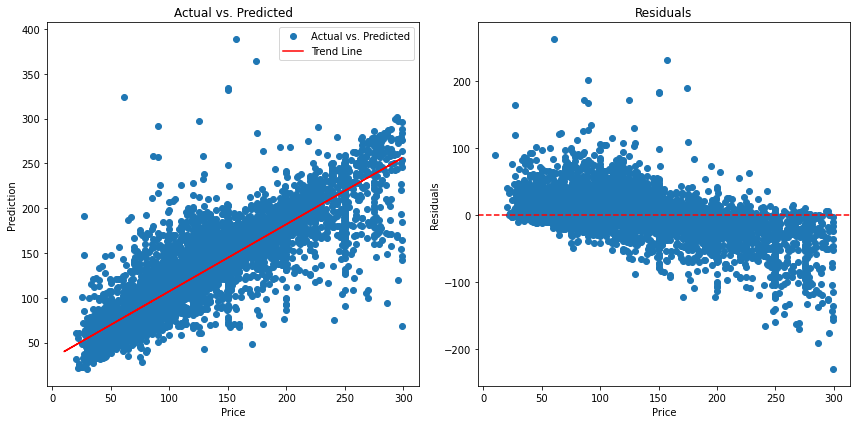

In [ ]:
result = pred_df.toPandas()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

# Scatter plot of actual prices and predicted prices with trend line
ax1.plot(result.price, result.prediction, 'o', label='Actual vs. Predicted')
coefficients = np.polyfit(result.price, result.prediction, 1)
trendline = np.polyval(coefficients, result.price)
ax1.plot(result.price, trendline, color='r', label='Trend Line')
ax1.set_xlabel("Price")
ax1.set_ylabel("Prediction")
ax1.set_title("Actual vs. Predicted")
ax1.legend()

# Residual plot
residuals = result.prediction - result.price
ax2.plot(result.price, residuals, 'o', label='Residuals')
ax2.axhline(0, color='r', linestyle='--')
ax2.set_xlabel("Price")
ax2.set_ylabel("Residuals")
ax2.set_title("Residuals")

plt.tight_layout()
plt.show()

Overall, below is our interpretation of the given evaluation metrics that provide insights into the performance of a regression model:

1. **Root Mean Squared Error** (RMSE): The RMSE value indicates the average magnitude of the residuals, which represents the differences between the predicted values and the actual values. A lower RMSE value obtained from the tuned model suggests that the model's predictions are closer to the actual values, indicating better accuracy. In this case, the RMSE value indicates that, on average, the predicted values deviate by approximately 31.49 units from the actual values.
2. **R-squared** (R2): The R2 value represents the proportion of the variance in the dependent variable that is explained by the independent variables in the model. An R2 value of 0.75 suggests that approximately 75.86% of the variability in the dependent variable can be explained by the independent variables. A higher R2 value obtained from the tuned model indicates that the model captures a larger proportion of the underlying patterns and provides a better fit to the data.
3. **Residual**: The average residual of -0.9973481319632769 represents the mean difference between the predicted and actual values. In this case, it suggests that, on average, the predicted values are approximately 1 units lower than the actual values, and the model underestimates the actual values.

Taken together, these metrics suggest that the tuned model has improved significantly, and it has moderate predictive performance. The RMSE value indicates a reasonable level of prediction error, while the R2 value indicates that a significant portion of the variance in the dependent variable is explained by the independent variables.

## 6. Conclusion
---

To conclude our work for this project, we utilized a dataset obtained from Inside Airbnb, which included detailed information about New York City Airbnb listings. After performing data cleaning and exploratory data analysis, we gained valuable insights regarding super hosts, popular neighborhoods, and listing features.

We discovered that booking Airbnb units hosted by **super hosts** is advisable for better services, although it should be considered as just one criterion due to the insignificant differences in review scores. Furthermore, our location analysis revealed that **Bedford-Stuyvesant** in Brooklyn had the highest number of listings on Airbnb, indicating its popularity among hosts and guests. Additionally, we found that **entire home/apartment** listings were the most common, while **private rooms** were the most expensive and the second most popular listing type.

For our machine learning models, we experimented with various regression algorithms, including **linear regression, decision tree regression, gradient-boosted tree regression**, and **random forest regression**. After implementing and evaluating these models, we found that the gradient-boosted tree regression model outperformed the others.

The **model evaluation** was based on two key metrics: `RMSE` & `R2` score.

The gradient-boosted tree regression model achieved the lowest `RMSE` of `41.24`, indicating that it had the smallest average deviation between the predicted and actual listing prices. Additionally, it attained the highest `R2` score of `0.59`, indicating that the model explained approximately 59% of the variance in the target variable.

Given its superior performance, we selected the gradient-boosted tree regression model for further optimization. To fine-tune the model's hyperparameters, we utilized Spark's `ParamGridBuilder`, which allowed us to systematically explore different combinations of hyperparameter values. We employed 3-fold cross-validation to ensure robustness and avoid overfitting.

After **hyperparameter tuning**, the optimized gradient-boosted tree regression model revealed improved performance. The selected hyperparameters were `maxDepth = 50` and `maxIter = 9`. These values determined the maximum depth of the individual decision trees within the ensemble and the number of iterations to train the model, respectively.

The refined model demonstrated a significant enhancement in performance. The `RMSE` decreased to `31.49`, indicating a more accurate prediction of listing prices. Moreover, the `R2` score increased to `0.76`, implying that approximately 76% of the variance in the target variable could be explained by the model.

Additionally, we assessed the `residuals` of the optimized model, which yielded a value of -0.9973, indicating a reasonably good fit. The proximity of the residual value to zero suggests that the model's predictions were generally close to the true values.

Overall, the optimized gradient-boosted tree regression model, with the hyperparameters `maxDepth` at 50 and `maxIter` at 9, proved to be the most effective in predicting Airbnb listing prices based on the selected features from the dataset.

## 7. References

Dataset from Inside Airbnb website: http://insideairbnb.com/new-york-city